In [1]:
import os
import re
import sys
import glob
import json

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from Gaugi import load as gload

sys.path.append('../../.__python__/')
# kolmov plotter
from kolmov.core.base_plotter import plot_monitoring

# SP index definition
def calc_sp(pd, fa):
    g_mean = np.sqrt((1-fa) * pd)
    a_mean = ((1-fa) + pd)/2.
    return np.sqrt(g_mean*a_mean)

# Open the file

The file here has only 1 initialization for each sort in each model.

In [2]:
base_path = '/volume'

In [3]:
cv_df = pd.read_csv(os.path.join(base_path, 'cv_table_v1_nohad.csv'))

In [4]:
cv_df.head()

,train_tag,et_bin,eta_bin,model_idx,sort,init,file_name,total_sgn,total_bkg,max_sp_val,max_sp_pd_val,max_sp_fa_val,auc_val,max_sp_op,max_sp_pd_op,max_sp_fa_op,auc_op
0,v1_nohad,0,0,0,0,8,tunedDiscr.jobID_0000.pic.gz,28455,205005,0.941784,0.968377,0.084439,0.978992,0.938199,0.956247,0.079676,0.978314
1,v1_nohad,0,0,0,1,43,tunedDiscr.jobID_0004.pic.gz,28455,205005,0.938560,0.960295,0.082927,0.976318,0.937698,0.956001,0.080427,0.978230
2,v1_nohad,0,0,0,2,23,tunedDiscr.jobID_0002.pic.gz,28455,205005,0.934502,0.941321,0.072293,0.975314,0.937448,0.954630,0.079579,0.977537
3,v1_nohad,0,0,0,3,28,tunedDiscr.jobID_0002.pic.gz,28455,205005,0.937192,0.956781,0.082195,0.978030,0.937805,0.957301,0.081491,0.978082
4,v1_nohad,0,0,0,4,20,tunedDiscr.jobID_0002.pic.gz,28455,205005,0.938182,0.957836,0.081268,0.976505,0.938043,0.954490,0.078262,0.978116


# Box plot analysis

Create a box plot to get an overview of all trained models and use the parsimony to choose the best model for each bin.

In [5]:
# set the real ranges in kinematic regions
et_range = ['[4, 7[ GeV', '[7, 10[ GeV', '[10, 15[ GeV']
eta_range = ['[0.0, 0.8[', '[0.8, 1.37[', '[1.37, 1.54[', '[1.54, 2.37', '[2.37, 2.47[']

In [6]:
map_key_dict ={
   'max_sp_val'    : (r'$SP_{max}$ (Validation)', 'sp'),
   'max_sp_pd_val' : (r'$P_D$ (Validation)', 'pd'),
   'max_sp_fa_val' : (r'$F_A$ (Validation)', 'fa'),
   'auc_val'       : (r'AUC (Validation)', 'auc'),
}

# using as simple function in order to make easier plot all need measures
def create_cool_box_plot(df, key, mapped_key, output_name, tuning_flag):
    # create the box plot. 
    # rename the columns names.
    # map the model idx into real # neurons.

    sns.factorplot(data=(df
                        .replace({'model_idx' : {i :  n for i, n in zip(range(0,10+1),
                        range(5,15+1))},
                                'et_bin'    : {i : et_range[i] for i in range(3)},
                                'eta_bin'   : {i : eta_range[i] for i in range(5)}})
                        .rename({'model_idx'  : '# Neurons',
                                'et_bin'     : r'$E_T$',
                                'eta_bin'    : r'$\eta$',
                                key : mapped_key},
                        axis=1)), x='# Neurons',
                        y=mapped_key, col=r'$\eta$', 
                        row=r'$E_T$', kind='box', sharey=False)

    plt.savefig(os.path.join(base_path, 'box_plot_%s_%s.png' %(output_name, tuning_flag)), dpi=300)

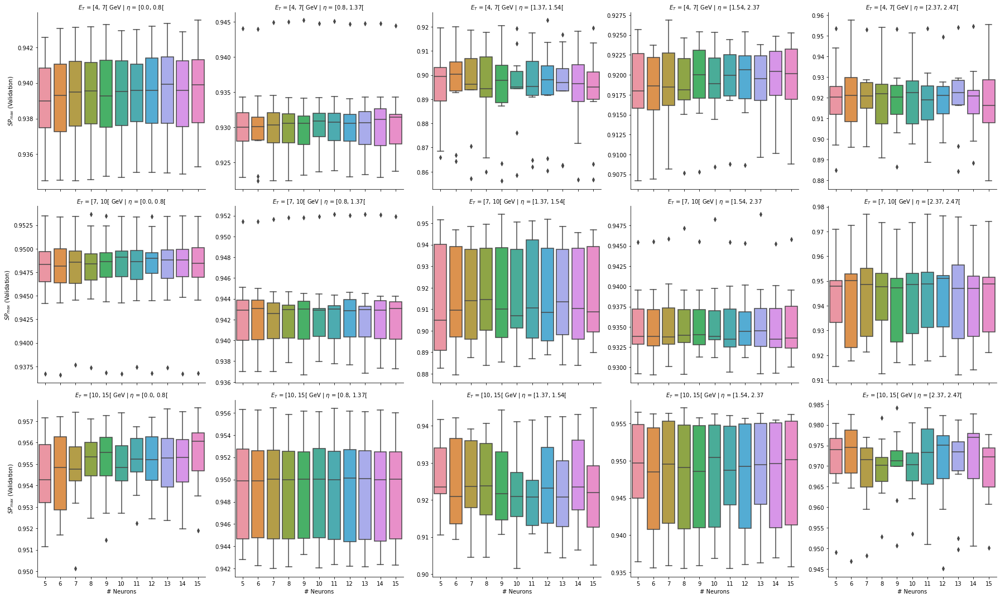

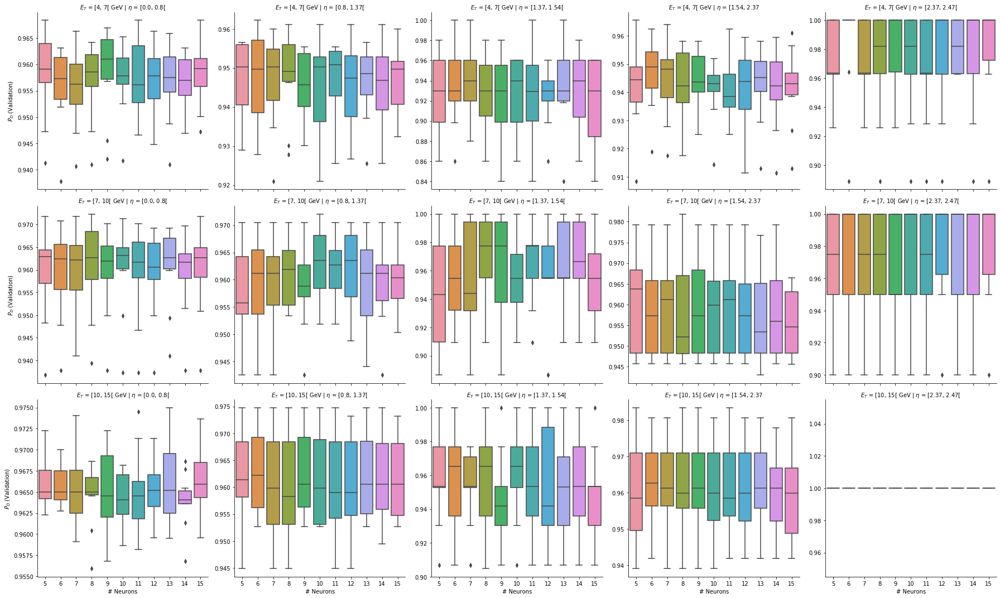

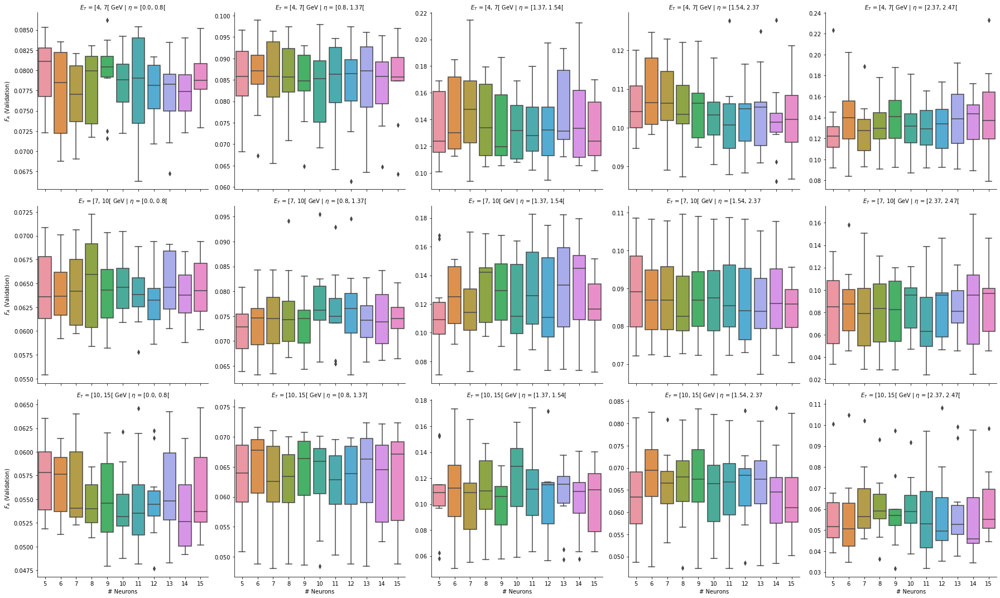

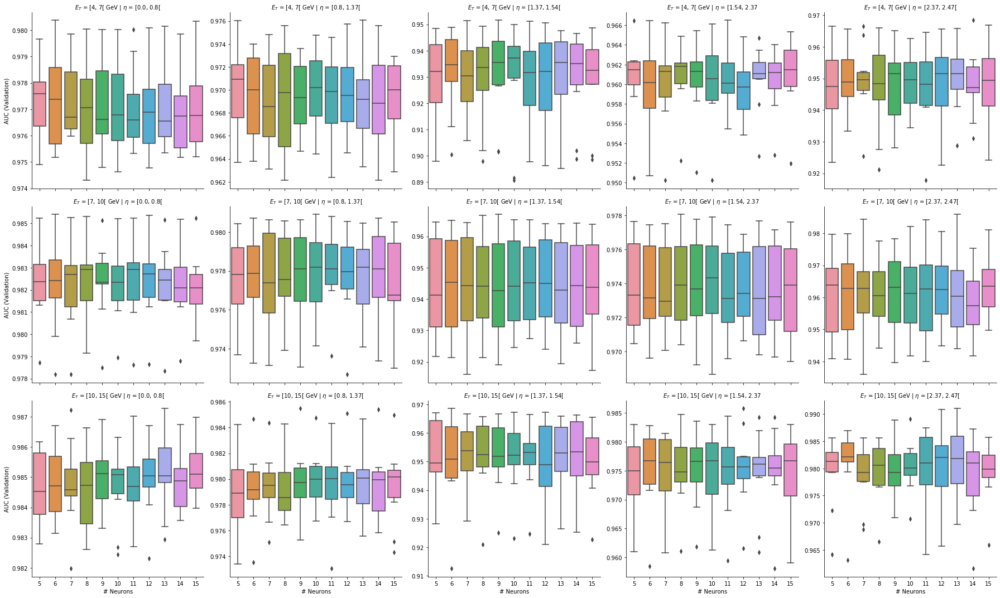

In [7]:
for ikey in map_key_dict.keys():
    map_k, o_name = map_key_dict[ikey]
    create_cool_box_plot(df=cv_df, key=ikey, mapped_key=map_k, output_name=o_name, tuning_flag='v1_nohad')

A good choice can ben $5$ or $6$ neurons, but using the $AUC$ a better choice in most of cases is $6$ neurons... So proceding using this model...

In [8]:
# filter to get only the model with 6 neurons
print('There are %i before filter the models...' %(len(cv_df)))
cv_df = cv_df.loc[cv_df.model_idx==0, :] # model_idx==1 is the model with 6 neurons...
print('There are %i after filtering the models...' %(len(cv_df)))

There are 1650 before filter the models...
There are 150 after filtering the models...


In [9]:
# calculate the cross-validation efficiency (in %) and dump into a .csv file
cross_val_keys = ['max_sp_val', 'max_sp_pd_val', 'max_sp_fa_val', 'auc_val']
(cv_df.groupby(['et_bin', 'eta_bin'])[cross_val_keys]
                .agg(['mean', 'std'])
                .apply(lambda x: 100*x)
                .reset_index()
                .to_csv(os.path.join(base_path, 'cross_val_table_v1_nohad.csv'), index=False))

# Plot the Train Monitoring

In [10]:
plot_tool = plot_monitoring(os.path.join(base_path, 'models_history_v1_nohad'), model_idx=0)

dict_keys(['et2_eta4_sort_5', 'et0_eta1_sort_2', 'et1_eta2_sort_9', 'et0_eta3_sort_3', 'et0_eta0_sort_7', 'et1_eta3_sort_7', 'et2_eta0_sort_4', 'et1_eta0_sort_3', 'et2_eta0_sort_7', 'et2_eta4_sort_7', 'et2_eta3_sort_2', 'et0_eta4_sort_2', 'et0_eta2_sort_3', 'et1_eta3_sort_5', 'et2_eta2_sort_7', 'et0_eta3_sort_1', 'et2_eta0_sort_1', 'et1_eta1_sort_2', 'et2_eta1_sort_6', 'et0_eta4_sort_3', 'et1_eta1_sort_5', 'et1_eta0_sort_8', 'et2_eta1_sort_0', 'et0_eta1_sort_7', 'et0_eta4_sort_4', 'et2_eta1_sort_3', 'et1_eta1_sort_8', 'et0_eta3_sort_5', 'et2_eta1_sort_9', 'et2_eta4_sort_8', 'et1_eta1_sort_3', 'et1_eta3_sort_4', 'et2_eta4_sort_9', 'et0_eta2_sort_4', 'et1_eta4_sort_3', 'et2_eta3_sort_7', 'et0_eta3_sort_2', 'et2_eta0_sort_6', 'et0_eta0_sort_8', 'et0_eta3_sort_9', 'et0_eta1_sort_6', 'et1_eta2_sort_2', 'et1_eta2_sort_6', 'et0_eta1_sort_0', 'et1_eta4_sort_9', 'et2_eta4_sort_3', 'et2_eta1_sort_7', 'et1_eta2_sort_4', 'et0_eta2_sort_9', 'et0_eta2_sort_0', 'et2_eta0_sort_8', 'et1_eta3_sort_6', '

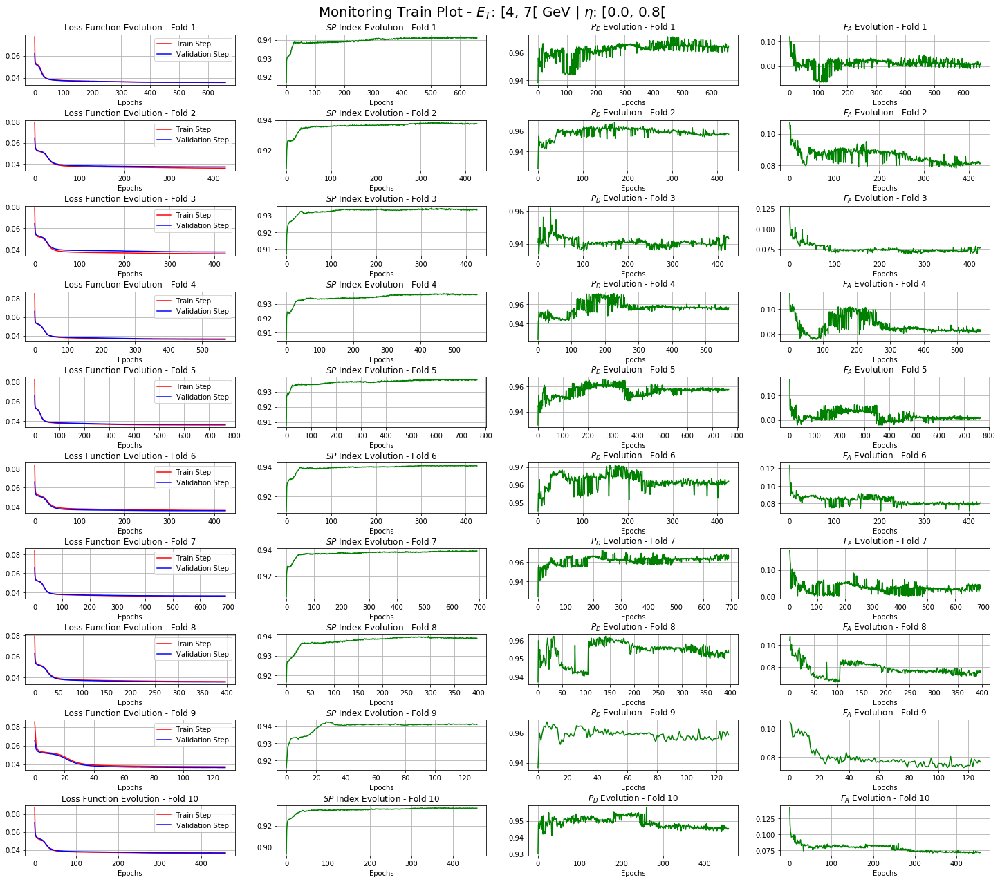

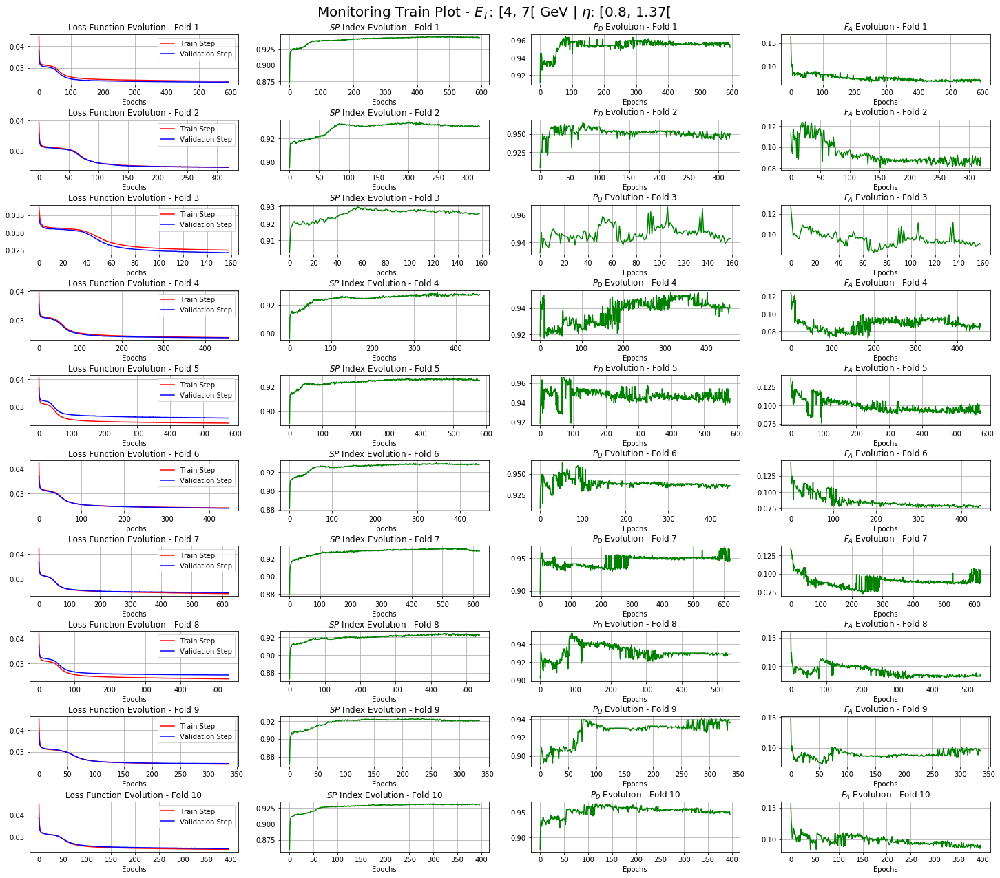

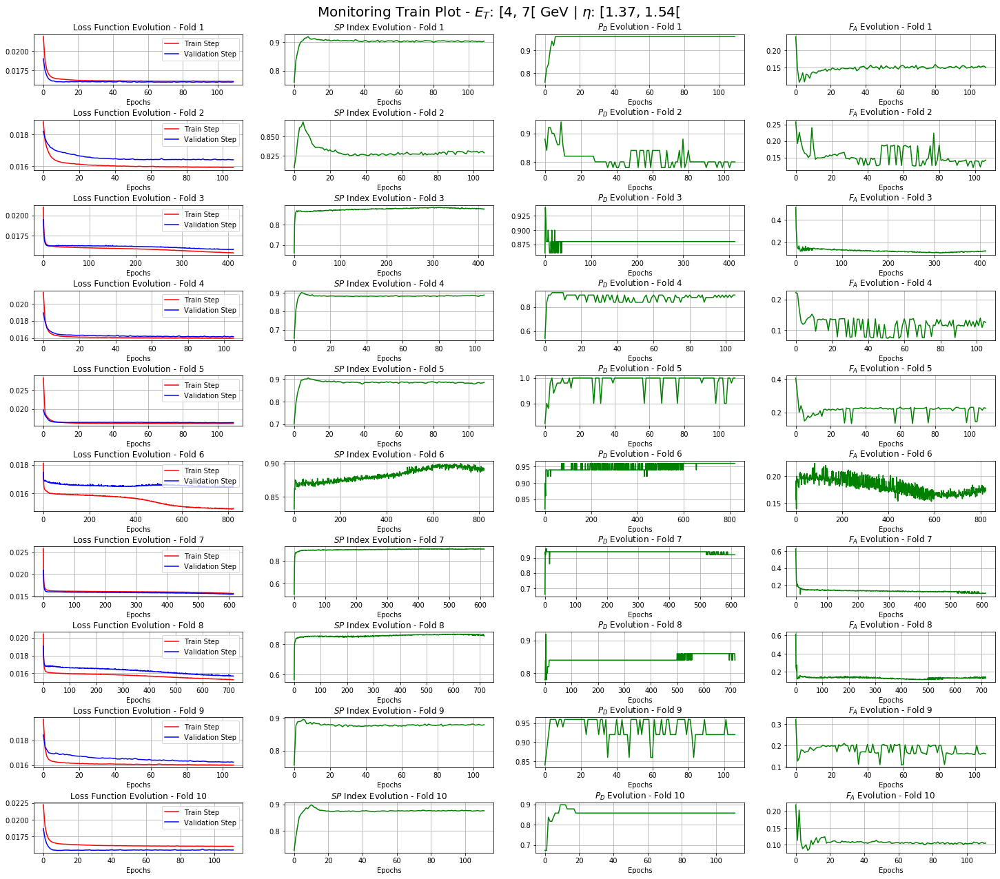

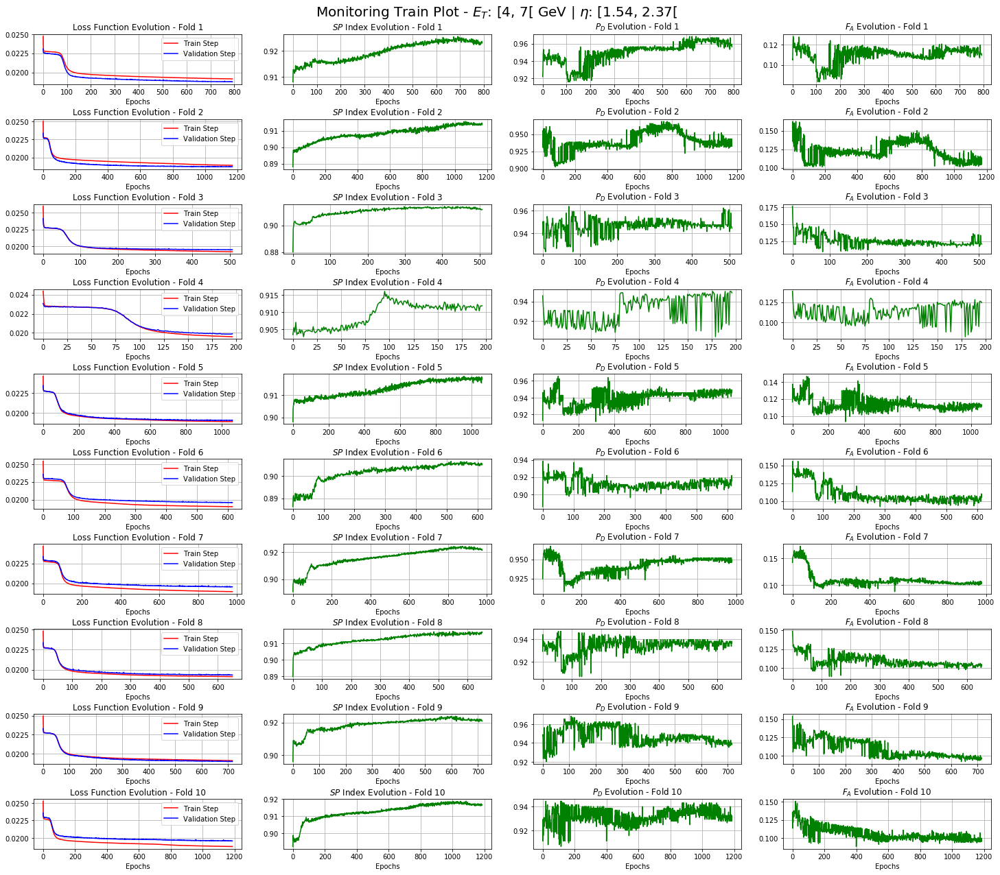

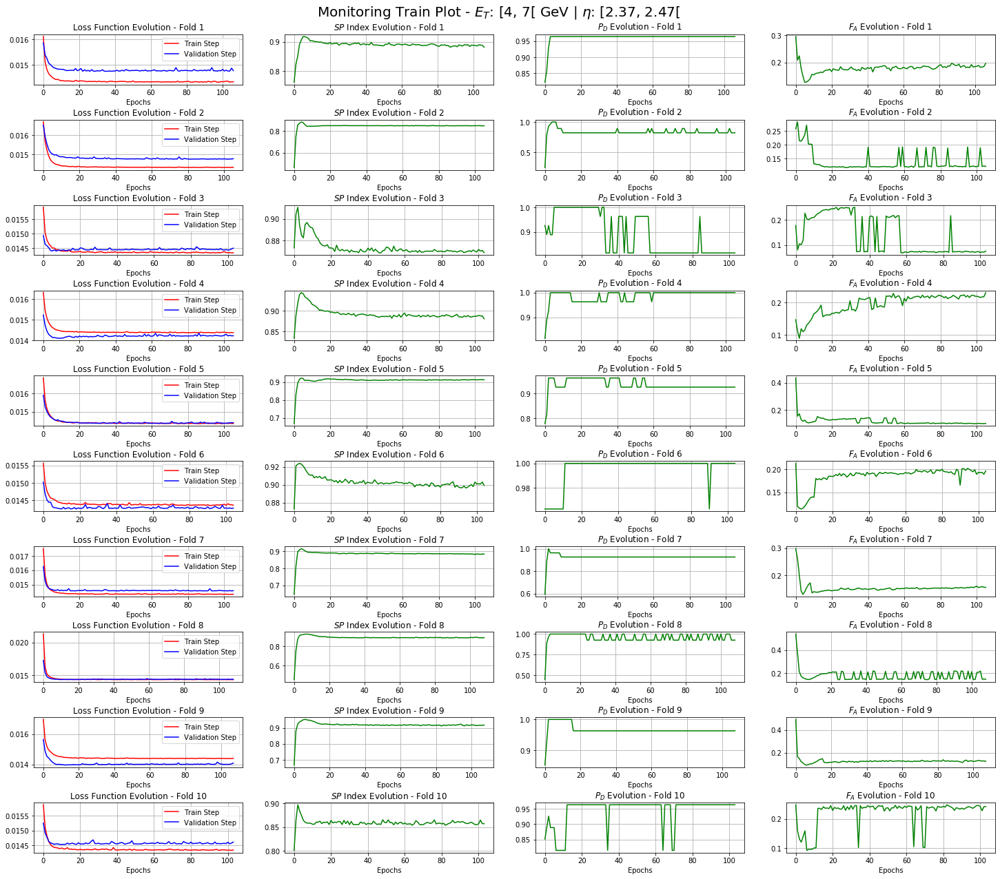

...

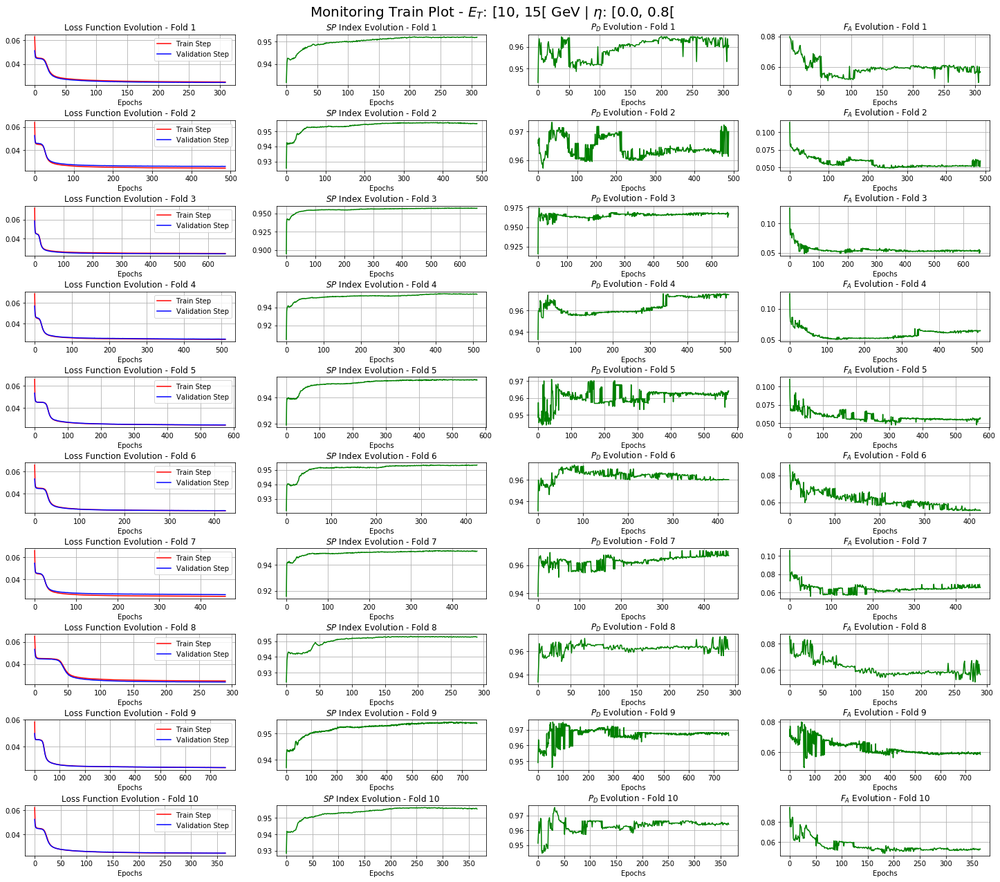

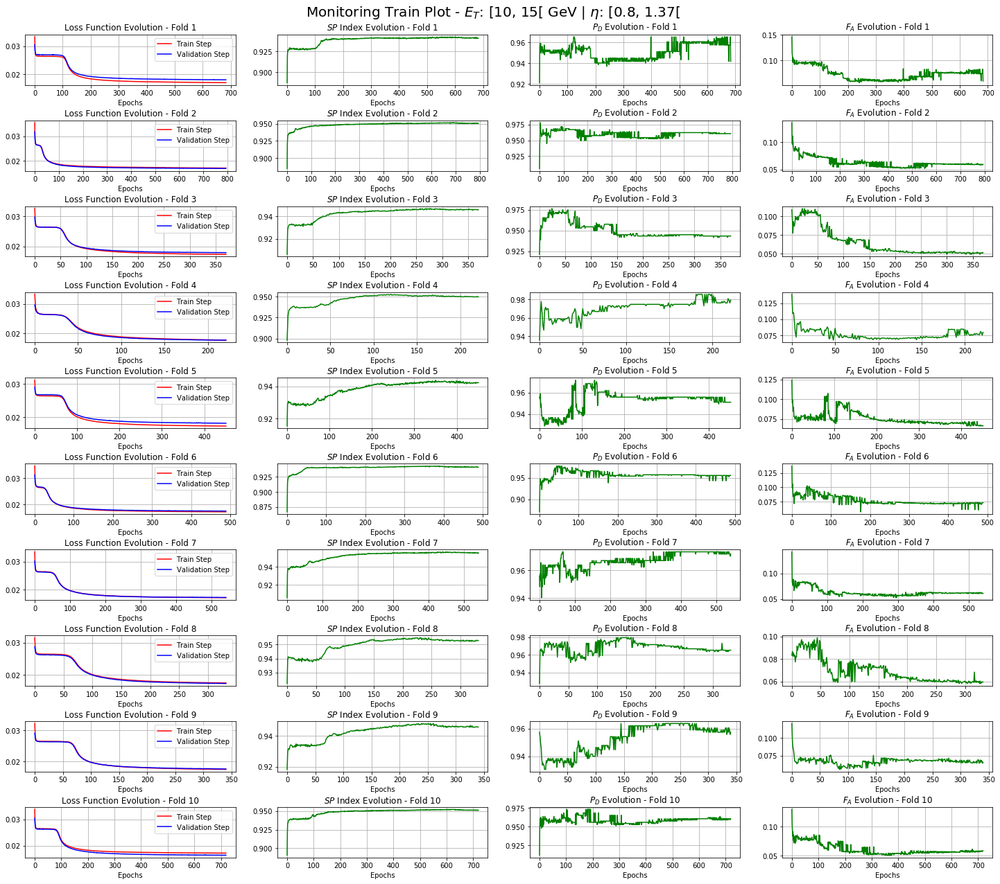

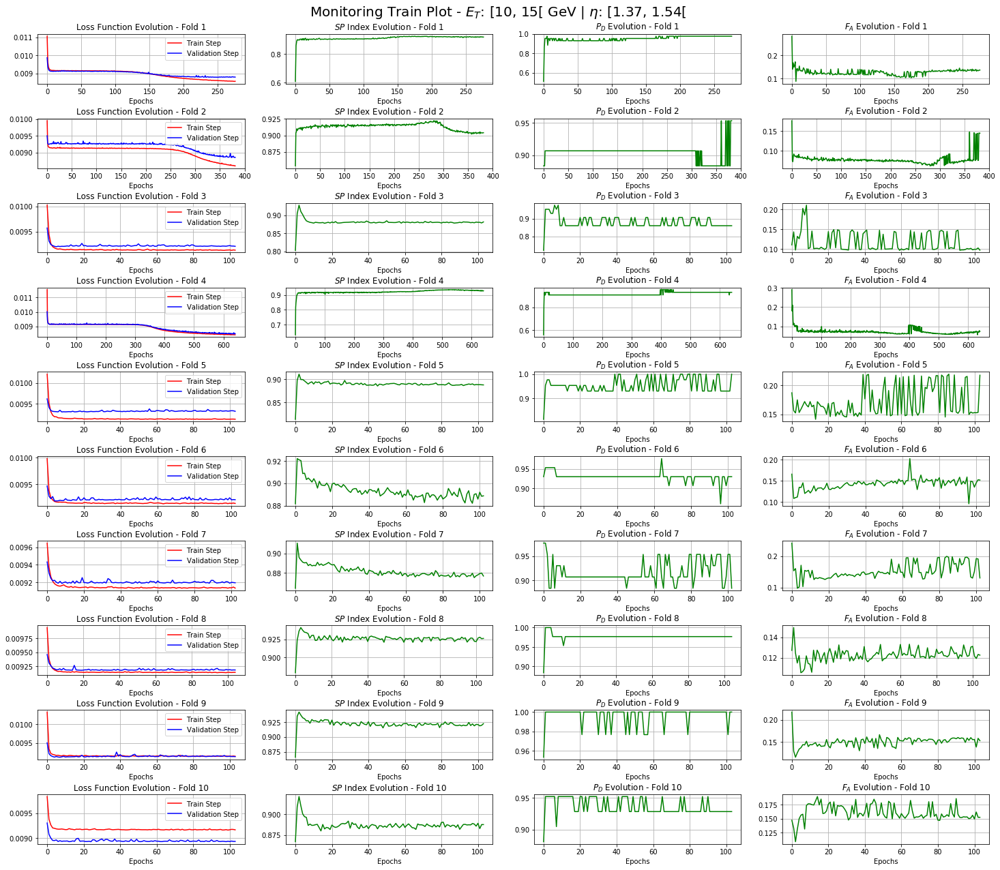

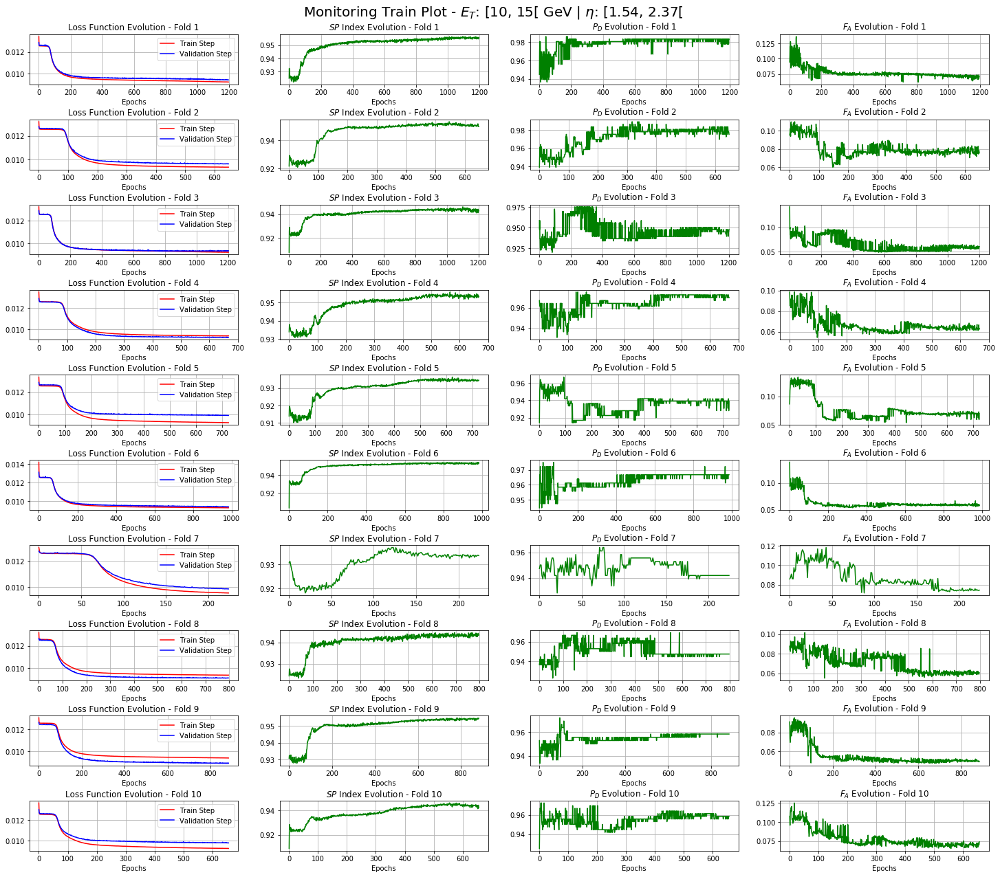

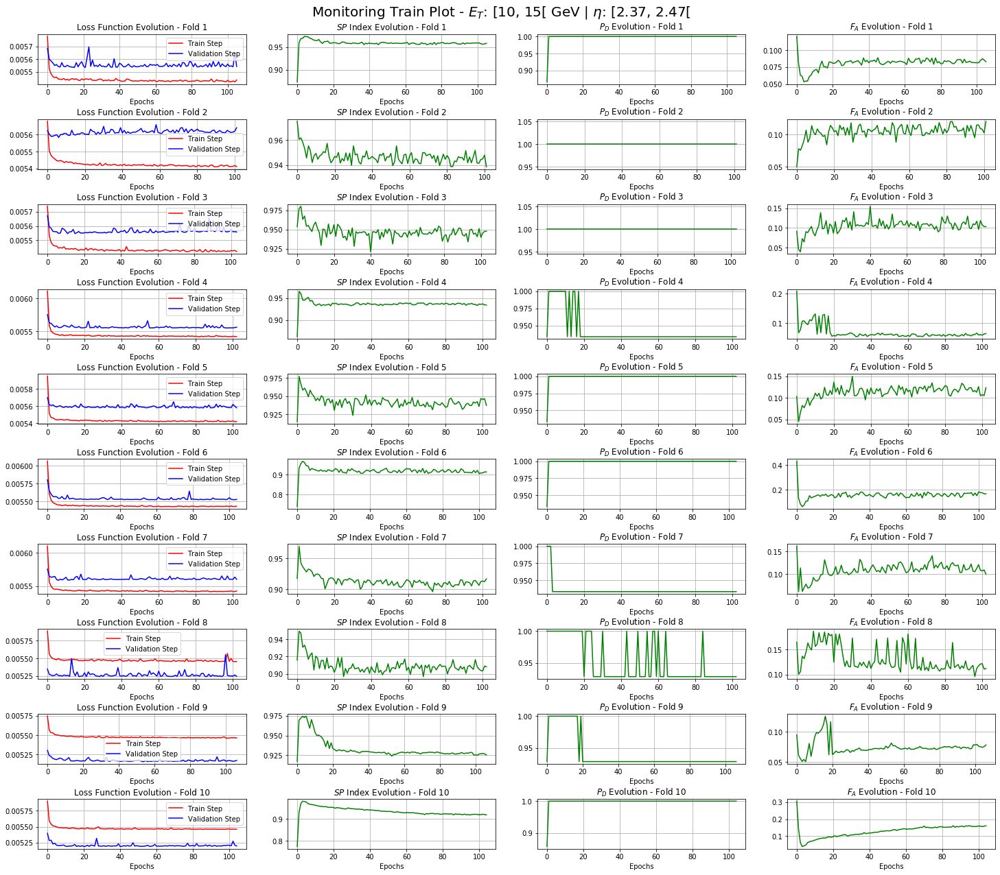

In [11]:
import itertools

for iet, ieta in itertools.product(range(3), range(5)):
    plot_name = 'monitoring_v1_nohad_et%i_eta%i' %(iet, ieta)
    plot_tool.plot_monitoring_curves(et_bin=iet,
                                     eta_bin=ieta,
                                     plot_path=base_path, plot_name=plot_name)

# Calculate the Integrated Cross-Validation Efficiency

In [12]:
cv_df['passed_sgn'] = cv_df.max_sp_pd_val * cv_df.total_sgn
cv_df['passed_bkg'] = cv_df.max_sp_fa_val * cv_df.total_bkg
cv_df['passed_sgn'] = cv_df.passed_sgn.astype(np.int)
cv_df['passed_bkg'] = cv_df.passed_bkg.astype(np.int)
cv_df.loc[:, ['model_idx', 'sort', 'et_bin', 'eta_bin', 'max_sp_pd_val', 'max_sp_fa_val', 'passed_sgn', 'total_sgn', 'passed_bkg', 'total_bkg']]

,model_idx,sort,et_bin,eta_bin,max_sp_pd_val,max_sp_fa_val,passed_sgn,total_sgn,passed_bkg,total_bkg
0,0,0,0,0,0.968377,0.084439,27555,28455,17310,205005
1,0,1,0,0,0.960295,0.082927,27325,28455,17000,205005
2,0,2,0,0,0.941321,0.072293,26785,28455,14820,205005
3,0,3,0,0,0.956781,0.082195,27225,28455,16850,205005
4,0,4,0,0,0.957836,0.081268,27255,28455,16660,205005
...,...,...,...,...,...,...,...,...,...,...
1545,0,5,2,4,1.000000,0.063747,147,147,1630,25575
1546,0,6,2,4,1.000000,0.061009,147,147,1560,25575
1547,0,7,2,4,1.000000,0.100469,147,147,2569,25575
1548,0,8,2,4,1.000000,0.050430,147,147,1289,25575


In [13]:
total_sgn, total_bkg = (cv_df.loc[cv_df.sort==0,:]
                        .groupby(['et_bin', 'eta_bin'])
                        .agg({'total_sgn' : 'sum',
                              'total_bkg' : 'sum' })
                        .sum(axis=0))

print('# signal: %i | # background: %i' %(total_sgn, total_bkg))

# signal: 107227 | # background: 1694232


In [14]:
integrated_table = (cv_df
                    .groupby(['sort'])
                    .agg({'passed_sgn' : 'sum',
                          'passed_bkg' : 'sum' }))
integrated_table

,passed_sgn,passed_bkg
sort,,
0,103417,134315
1,102855,135244
2,102303,129125
3,103054,133585
4,102610,137576
5,102188,131955
6,102895,140774
7,102556,132783
8,103016,131695


In [15]:
integrated_table.passed_sgn = integrated_table.passed_sgn / total_sgn
integrated_table.passed_bkg = integrated_table.passed_bkg / total_bkg
integrated_table['sp']      = calc_sp(integrated_table.passed_sgn,
                                      integrated_table.passed_bkg)
integrated_table = 100*integrated_table
integrated_table

,passed_sgn,passed_bkg,sp
sort,,,
0,96.446790,7.927781,94.246813
1,95.922669,7.982614,93.959882
2,95.407873,7.621447,93.887104
3,96.108256,7.884693,94.101191
4,95.694182,8.120257,93.777264
5,95.300624,7.788485,93.749708
6,95.959973,8.309016,93.813337
7,95.643821,7.837356,93.895165
8,96.072817,7.773139,94.140019


In [17]:
integrated_table.agg(['mean', 'std']).rename({'passed_sgn' : 'PD',
                                              'passed_bkg' : 'FA',
                                              'sp'         : 'SP'}, axis=1).round(2).T

,mean,std
PD,95.82,0.35
FA,7.86,0.26
SP,93.97,0.17


In [18]:
cv_df.columns

Index(['train_tag', 'et_bin', 'eta_bin', 'model_idx', 'sort', 'init',
       'file_name', 'total_sgn', 'total_bkg', 'max_sp_val', 'max_sp_pd_val',
       'max_sp_fa_val', 'auc_val', 'max_sp_op', 'max_sp_pd_op', 'max_sp_fa_op',
       'auc_op', 'passed_sgn', 'passed_bkg'],
      dtype='object')

In [19]:
op_models = cv_df.loc[cv_df.groupby(['et_bin', 'eta_bin'])['max_sp_op'].idxmax(), :].copy()

In [20]:
op_models.to_csv(os.path.join(base_path, 'op_models_v1_nohad.csv'), index=False)